In [146]:
using JLD2
using MIRT: jim
using Plots: plot, plot!, @layout, grid, savefig
using Images: assess_psnr

# Useful to flip images
function rev(img::AbstractArray{T, 2}) where T
    img[end:-1:1, end:-1:1]
end

normIm = (x) -> abs.(x) |> (x) -> x/max(x...); 

# Load the data
datafile = joinpath("C:\\Users\\Nick\\Desktop\\data", "files_1_5_results.jld2");
@load datafile x̂ PSNR RMSE testR fNames imgs sampleMasks noisy_imgs
nR = length(testR)
nImgs = length(imgs);

In [152]:
plotImg = Array{Any}(undef, nImgs, 2)
for i = 1:nImgs
    plotImg[i, 1] = jim(abs.(rev(imgs[i])))
    noisyPSNR = assess_psnr(noisy_imgs[i], imgs[i]) |> (x) -> round(x, digits = 2)
    plotImg[i, 2] = jim(abs.(rev(noisy_imgs[i])), title = "PSNR = $noisyPSNR")
end
plot!(plotImg[1, 1], ylabel = "Reference")
plot!(plotImg[1, 2], ylabel = "Noisy Reference")
plot(plotImg..., layout = (2, nImgs), colorbar = false, size = (900,500), titlefontsize = 10)

In [233]:
# Add titles, remove ylabel on first image
plot(plotImg[:, 1]..., ylabel = "", title = "Reference");

# Sample Masks

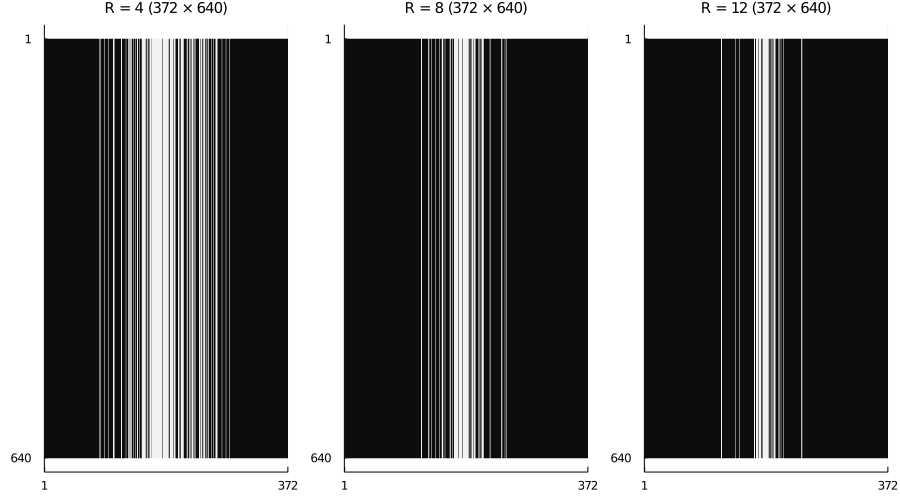

In [322]:
plotMasks = Dict{typeof((1,1,1)), Any}()
for (key, mask) in sampleMasks
    (R, M, N) = key
    push!(plotMasks, key => jim(mask, title = "R = $R ($M × $N)"))
end
(M, N) = 372, 640
plot(plotMasks[testR[2], M, N],
     plotMasks[testR[3], M, N],
     plotMasks[testR[4], M, N],
     layout = (1, :),
    colorbar = false,
    size = (900,500),
    titlefontsize = 10)

In [324]:
savefig("sampleMasks.pdf")

# Plot Reconstructed Images

In [159]:
plotRecons = Dict(key =>  [plot() for i in 1:nImgs, iR in 1:nR] for (key, _) in x̂)
for (key, _) in x̂, i = 1:nImgs, iR in 1:nR
    # Activate plot
    plot(plotRecons[key][i, iR])
    # Get R, M, N
    R = testR[iR]
    (M, N) = size(imgs[i])
    # Get psnr, plot
    _psnr = round(PSNR[key][i, iR], digits = 2)
    plotRecons[key][i, iR] = jim(
        rev(x̂[key][i, iR]),
        title = " $(key[1])-$(key[2]) \n PSNR = $_psnr \n R = $R "
    )

end


### Plot one plug, one knee, ADMM and POGM

In [325]:
_plug = "dncnn"
i = 1
l = @layout [
    a{0.3w} grid(2, nR)
             
]
plot(plotImg[i, 1], plotRecons[_plug, "admm"][i, :]..., plotRecons[_plug, "pogm"][i, :]..., 
    layout = l, colorbar = false, 
    size = (1500, 900))

### One knee, one R, all plugs, admm and pogm

In [223]:
_iR = 3
i = 1
l = @layout [
    a{0.3w} grid(2, 5)
             
]
# 
_admmPlots =[plotRecons[_p, "admm"][i, _iR] for _p in ["dncnn", "nlm", "tv", "bm3d", "norm"]]
_pogmPlots =[plotRecons[_p, "pogm"][i, _iR] for _p in ["dncnn", "nlm", "tv", "bm3d", "norm"]]

plot(plotImg[i], _admmPlots..., _pogmPlots..., 
    layout = l, colorbar = false, 
    size = (1500, 750))

In [224]:
savefig("knee" * string(i) *"R" * string(testR[_iR]) * "pogm_admm.pdf" )

### One knee, one plug, one R, ADMM and POGM

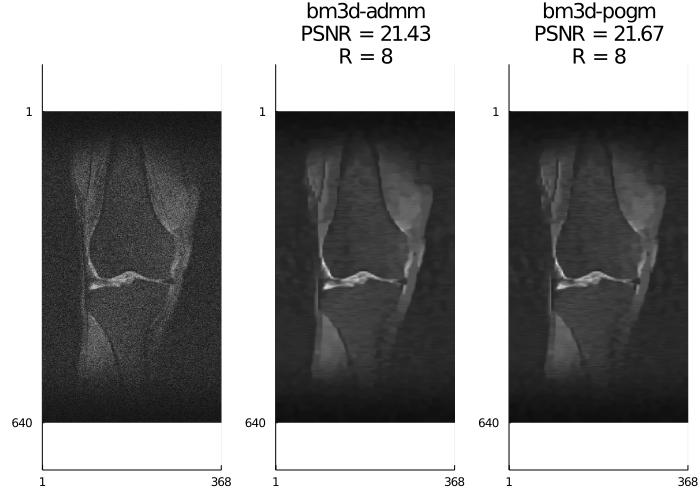

In [209]:
_plug = "bm3d"
i  = 2
iR = 3

plot(plotImg[i], plotRecons[_plug, "admm"][i, iR], plotRecons[_plug, "pogm"][i, iR], 
    layout = (1, :), colorbar = false, 
    size = (700, 500))

### One plug, one R, many knees, ADMM and POGM

In [225]:
_plug = "bm3d"
iR = 3
# Need to make a grid an permute to get the plot we want in correct order
_plotGrid = reshape([plotImg[:, 1]..., plotRecons[_plug, "admm"][:, iR]..., plotRecons[_plug, "pogm"][:, iR]...], nImgs, :)
_plotGrid = permutedims(_plotGrid, [2, 1])

plot(_plotGrid...,
    layout = (nImgs, :),
    size = (750, 2000), colorbar = false)

In [213]:
savefig(_plug*"_img_grid.pdf")

### One R, ADMM, subset of knees

In [244]:
_iR = 2
_admmPlots =[plotRecons[_p, "admm"][i, _iR] for i in [1,2, 4, 5], _p in ["dncnn", "nlm", "tv", "bm3d", "norm"]]
plot(plotImg[[1 2 4 5], 1]..., _admmPlots..., layout = (6, 4),
    size = (750, 2000), colorbar = false)

In [252]:
# Rotated version
_iR = 2
_admmPlots =[plotRecons[_p, "admm"][i, _iR] for i in [1,2, 4, 5], _p in ["tv", "dncnn", "nlm", "bm3d"]]
_plotGrid = reshape([plotImg[[1 2 4 5], 1]..., _admmPlots...], 4, 5)
_plotGrid = permutedims(_plotGrid, [2, 1])
plot(_plotGrid..., layout = (4, 5),
    size = (900, 900), colorbar = false, titlefontsize = 8)

### Do one row of the above

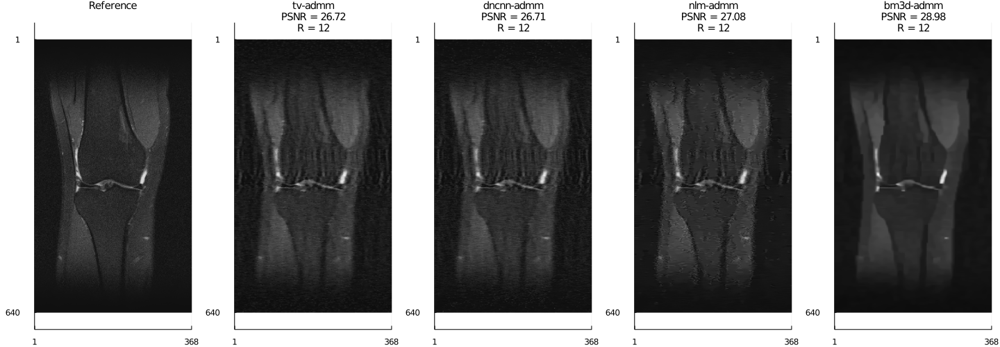

In [274]:
_iR = 4
i = 1
_admmPlots =[plotRecons[_p, "admm"][i, _iR] for _p in ["tv", "dncnn", "nlm", "bm3d"]]
plot(plotImg[i, 1], _admmPlots..., layout = (1, :),
    size = (1440, 500), colorbar = false, titlefontsize = 10)

In [275]:
savefig("img"*string(i)*"_R"*string(testR[_iR])*"_allPlugs.pdf")

# Plot Convergence

In [200]:
plotConv = Dict(key =>  [plot() for i in 1:nImgs] for (key, _) in x̂)
for (key, _) in x̂, i = 1:nImgs, iR in 2:nR
    # Activate plot
    plot(plotConv[key][i])
    # Get R, M, N
    R = testR[iR]
    (M, N) = size(imgs[i])
    # Get rmse, plot
    _rmse = RMSE[key][i, iR]
    plotConv[key][i] = plot!(_rmse, label = "R = $R", title = "Image $i")
    # Do conditional formatting
    if i == 1
        plot!(ylabel = "NRMSE - $(key[2])")
    else
        plot!(legend = false)
    end
end


### NRMSE, all images, admm and pogm, all R

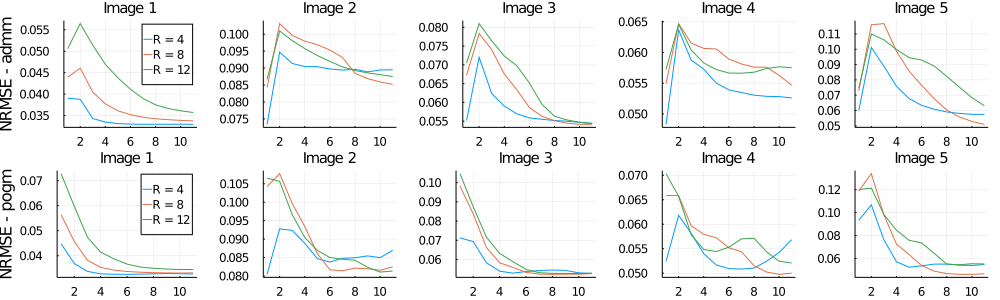

In [204]:
_plug = "bm3d"
plot(plotConv[(_plug, "admm")]..., plotConv[(_plug, "pogm")]...,
    layout = (2, :), colorbar = false,
    size = (1000, 300), titlefontsize = 10
    )

In [305]:
plotMeanRMSE = Dict(key =>  plot() for (key, _) in x̂)
for (key, _) in x̂, iR in 2:nR
    # Activate plot
    plot(plotMeanRMSE[key])
    # Get R, M, N
    R = testR[iR]
    (M, N) = size(imgs[i])
    # Get rmse, plot
    _rmse = RMSE[key][i, iR]
    plotMeanRMSE[key] = plot!(+(RMSE[key][:, iR]...)/nImgs, label = "R = $R", title = "$(key[1])-$(key[2])")
    plot!(xlabel = "Iteration")
    
    if key[2] == "admm"
        plot!(ylabel = "Mean NRMSE")
    else
#         plot!(legend = false)
    end
end

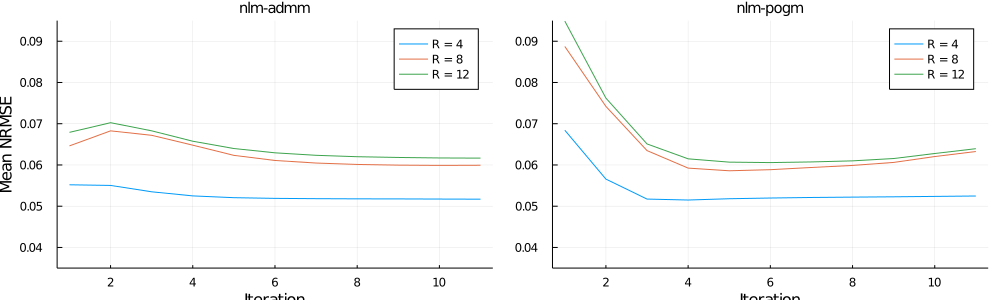

In [320]:
_plug = "nlm"
plot(plotMeanRMSE[(_plug, "admm")], plotMeanRMSE[(_plug, "pogm")],
    layout = (1, :), colorbar = false,
    size = (1000, 300), titlefontsize = 10,
    ylim = (0.035, 0.095))

In [321]:
savefig("meanErr_"*_plug*".pdf")


Figures:
    plug vs knees
    one knee (one plug, one R, admm v pogm)
    table of psnr
    all for one knee (plug by R by admm)F
    I deleted some items as I made them

Now waiting for zoom